Portfolio Audrey Hohmann, geospatial data scientist freelance

This notebook contains Exploratory Data Analysis (EDA) and Feature Engineering on geospatial data for the Sologne region. The aim of this project is to develop a machine learning model to predict wildfire hazard scores at the commune level.

# Import libraries and Functions 

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
import ee
import geopandas as gpd
import pandas as pd
import numpy as np
import json
import fiona
import pyogrio
import geemap
import folium
from pyproj import Transformer

In [36]:
pd.set_option('display.max_rows', 40)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', False)
pd.set_option('display.max_colwidth', 20)

In [5]:
# Authenticate with Google Earth Engine
ee.Authenticate()

# Initialize the Earth Engine client
ee.Initialize()

In [6]:
def check_shapefile_encoding(file_path):
    try:
        with fiona.open(file_path, encoding='utf-8') as shapefile:
            # Iterate over records to ensure they are read correctly
            for record in shapefile:
                pass  # Do nothing, just read to trigger any potential encoding errors
        print("Shapefile is correctly encoded in UTF-8.")
    except UnicodeDecodeError:
        print("Shapefile is not encoded in UTF-8.")
    except Exception as e:
        print(f"An error occurred: {e}")

In [7]:
#Function to check for bytes data and display the rows with bytes data
def display_bytes_data(df, column_name):
    # Filter rows where the column contains bytes data
    bytes_data_rows = df[df[column_name].apply(lambda x: isinstance(x, bytes))]
    return bytes_data_rows

In [8]:
# Function to check for bytes data in a GeoDataFrame
def check_for_bytes(df):
    columns_with_bytes = []
    for column in df.columns:
        if df[column].dtype == 'object':
            # Check if any values in the column are of type bytes
            if df[column].apply(lambda x: isinstance(x, bytes)).any():
                columns_with_bytes.append(column)
                print(f"Column '{column}' contains bytes data.")
            else:
                print(f"Column '{column}' does not contain bytes data.")
    return columns_with_bytes

## All path of the files projets 

In [9]:
# input wildfire and administrative boundaries files path

In [7]:
incendies_path = "./data/incendies/incendies.csv"

In [8]:
shp_dept = "./data/ADMIN-EXPRESS/1_DONNEES_LIVRAISON_2024-05-00047/ADE_3-2_SHP_LAMB93_FXX-ED2024-05-16/DEPARTEMENT.shp"

In [9]:
chfLieu_commune_path = "./data/ADMIN-EXPRESS/1_DONNEES_LIVRAISON_2024-05-00047/ADE_3-2_SHP_LAMB93_FXX-ED2024-05-16/CHFLIEU_COMMUNE.shp"

In [10]:
shp_com = "./data/ADMIN-EXPRESS/1_DONNEES_LIVRAISON_2024-05-00047/ADE_3-2_SHP_LAMB93_FXX-ED2024-05-16/COMMUNE.shp"

In [11]:
# output file path

In [12]:
dept_epsg4326_path = './data/departements_fr_epsg4326.geojson'

In [13]:
filtered_soldept_path = './data/dept_sologne.geojson'

In [14]:
communes_sol_path = './data/com_sologne.geojson'

In [15]:
communes_sol_path_parquet = './data/com_sologne.parquet'

In [16]:
wildfire_path = './data/wildfire_sol.geojson'

In [17]:
wildfire_path_parquet = './data/wildfire_sol.parquet'

In [28]:
com_wildfire_path_gjson = './data/com_wildfire.geojson'

In [29]:
com_wildfire_path_parquet = './data/df_feat_target.parquet'

In [30]:
com_wildfire_path_shp = './data/com_wildfire.shp'

In [31]:
com_wildfire_feat_path_gjson = './data/wildfire_sol_feat.geojson'

In [56]:
new_crs = 'EPSG:4326'

## Upload administrative boundaries files

In [24]:
# dept covered by Sologne forest
solo_dept = ['45', '41', '18']

### Cleaning and wrangling

In [25]:
check_shapefile_encoding(shp_dept)

Shapefile is correctly encoded in UTF-8.


In [26]:
dept_shp = gpd.read_file(shp_dept, encoding='utf-8')

In [27]:
dept_shp.crs

<Projected CRS: IGNF:LAMB93>
Name: RGF93 Lambert 93
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Lambert Conic Conformal (2SP)
Datum: Reseau Geodesique Francais 1993 v1
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [28]:
dept_shp.dtypes

ID             object
NOM_M          object
NOM            object
INSEE_DEP      object
INSEE_REG      object
geometry     geometry
dtype: object

In [29]:
dept_shp.head()

,ID,NOM_M,NOM,INSEE_DEP,INSEE_REG,geometry
0,DEPARTEM_FXX_000...,AIN,Ain,01,84,POLYGON ((838383...
1,DEPARTEM_FXX_000...,AISNE,Aisne,02,32,POLYGON ((708719...
2,DEPARTEM_FXX_000...,HAUTE-CORSE,Haute-Corse,2B,94,MULTIPOLYGON (((...
3,DEPARTEM_FXX_000...,CORSE-DU-SUD,Corse-du-Sud,2A,94,MULTIPOLYGON (((...
4,DEPARTEM_FXX_000...,ALLIER,Allier,03,84,POLYGON ((664478...


In [30]:
dept_shp.isna().mean()

ID           0.0
NOM_M        0.0
NOM          0.0
INSEE_DEP    0.0
INSEE_REG    0.0
geometry     0.0
dtype: float64

In [31]:
# Check for bytes data in the GeoDataFrame
columns_with_bytes = check_for_bytes(dept_shp)

Column 'ID' does not contain bytes data.
Column 'NOM_M' does not contain bytes data.
Column 'NOM' does not contain bytes data.
Column 'INSEE_DEP' does not contain bytes data.
Column 'INSEE_REG' does not contain bytes data.


In [32]:
dept_shp[dept_shp['NOM_M']=='ARDECHE']

,ID,NOM_M,NOM,INSEE_DEP,INSEE_REG,geometry
8,DEPARTEM_FXX_000...,ARDECHE,Ardèche,07,84,POLYGON ((803048...


In [33]:
# Save the transformed to geojson
dept_shp.to_crs(new_crs).to_file(dept_epsg4326_path, driver='GeoJSON', encoding='utf-8')

### Select Sologne dept and communes

In [34]:
dept_epsg4326 = gpd.read_file(dept_epsg4326_path, encoding='utf-8')

In [35]:
dept_sol = dept_epsg4326[dept_epsg4326['INSEE_DEP'].isin(solo_dept)]

In [36]:
dept_sol

,ID,NOM_M,NOM,INSEE_DEP,INSEE_REG,geometry
19,DEPARTEM_FXX_000...,CHER,Cher,18,24,POLYGON ((2.1568...
41,DEPARTEM_FXX_000...,LOIR-ET-CHER,Loir-et-Cher,41,24,POLYGON ((0.8367...
45,DEPARTEM_FXX_000...,LOIRET,Loiret,45,24,POLYGON ((2.8209...


In [37]:
# Save the filtered GeoDataFrame to a new geojson
dept_sol.to_file(filtered_soldept_path, driver='GeoJSON')

In [128]:
dept_sol.to_parquet("./data/dept_sologne.parquet")

Communes

In [38]:
communes = gpd.read_file(shp_com, encoding='utf-8')

In [39]:
len(communes)

34806

In [40]:
communes.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry
0,COMMUNE_00000000...,Villy-le-Pelloux,VILLY-LE-PELLOUX,74307,Commune simple,996,11,3,74,84,247400112,POLYGON ((941799...
1,COMMUNE_00000000...,Cuvat,CUVAT,74098,Commune simple,1611,11,3,74,84,247400112,POLYGON ((941651...
2,COMMUNE_00000023...,Tourneville-sur-Mer,TOURNEVILLE-SUR-MER,50272,Commune simple,1663,20,3,50,28,200067023,POLYGON ((370662...
3,COMMUNE_00000023...,Mansle-les-Fonta...,MANSLE-LES-FONTA...,16206,Commune simple,2105,05,3,16,75,200072023,POLYGON ((482978...
4,COMMUNE_00000023...,Bézac,BEZAC,09056,Commune simple,467,07,2,09,76,200066231,POLYGON ((583440...


In [41]:
communes.isna().mean()

ID            0.0
NOM           0.0
NOM_M         0.0
INSEE_COM     0.0
STATUT        0.0
POPULATION    0.0
INSEE_CAN     0.0
INSEE_ARR     0.0
INSEE_DEP     0.0
INSEE_REG     0.0
SIREN_EPCI    0.0
geometry      0.0
dtype: float64

In [42]:
communes_sol = communes[communes['INSEE_DEP'].isin(solo_dept)]

In [43]:
# Number of communes in Sologne
len(communes_sol)

878

In [44]:
# Save the transformed to geojson
communes_sol.to_crs(new_crs).to_file(communes_sol_path, driver='GeoJSON', encoding='utf-8')

In [127]:
# saved to parquet
communes_sol.to_crs(new_crs).to_parquet(communes_sol_path_parquet)

# Visualize administrative vector data in geemap

In [45]:
m = geemap.Map(center=(47.70012, 1.89975), zoom=8)

In [ ]:
m

In [49]:
style_r = {
    "color": "#ff0000",
    "width": 2,
    "lineType": 'solid',
    "fillColor": "#ff000010"
}

In [52]:
style_b = {
    "color": "#000000",
    "fillColor": "#000000",
}

In [ ]:
m.add_geojson(dept_epsg4326_path, style=style_b, layer_name="Departements")

In [ ]:
#Map.add_shapefile(filtered_soldept_path , style=style_r, layer_name="Sologne Departements")

In [47]:
sologne_depts = geemap.geojson_to_ee(filtered_soldept_path)

In [ ]:
#sologne_depts = ee.FeatureCollection("Départements").filter(
    #ee.Filter.inList("INSEE_DEP", ['45', '41', '18']))

In [50]:
m.addLayer(sologne_depts.style(**style_r), {}, 'Sologne_depts')

In [51]:
# bbox list in the format [xmin, ymin, xmax, ymax]
bboxsol_dept = geemap.ee_to_bbox(sologne_depts)

In [52]:
bboxsol_dept

[0.580493246356561, 46.42047317551321, 3.128677660045099, 48.34495658984705]

### Combine with wildfire information

In [53]:
wildfire_cvl = pd.read_csv(incendies_path, skiprows=3, sep=";")

In [54]:
wildfire_cvl.head()

,Année,Numéro,Département,Code INSEE,Nom de la commune,Date de première alerte,Origine de l'alerte,Moyens de première intervention,Surface parcourue (m2),Surface forêt (m2),Surface maquis garrigues (m2),Autres surfaces naturelles hors forêt (m2),Surfaces agricoles (m2),Autres surfaces (m2),Surface autres terres boisées (m2),Surfaces non boisées naturelles (m2),Surfaces non boisées artificialisées (m2),Surfaces non boisées (m2),Précision des surfaces,"Surface de feu à l'arrivée des secours > 0,1 ha",Voie carrossable la plus proche,Activité ou habitation la plus proche,Type de peuplement,Connaissance de la cause,Source de l'enquête,Nature,Intervention de l'équipe RCCI,Hygrométrie (%),Vitesse moyenne du vent (Km/h),Direction du vent,Température (°C),Commentaire,Précision de la donnée,Présence d'un contour valide
0,2006,125,45,45049,Bouzy-la-Forêt,2006-06-10 16:03:00,Indéterminé,NaN,2496,2496,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non
1,2006,121,45,45145,Ferrières-en-Gât...,2006-07-15 16:30:00,Indéterminé,NaN,3000,0,NaN,3000.0,NaN,NaN,3000,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non
2,2006,115,45,45145,Ferrières-en-Gât...,2006-07-17 13:48:00,Indéterminé,NaN,1000,1000,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non
3,2006,116,45,45145,Ferrières-en-Gât...,2006-07-17 16:38:00,Indéterminé,NaN,100,0,NaN,100.0,NaN,NaN,100,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non
4,2006,118,45,45272,Saint-Cyr-en-Val,2006-07-18 10:15:00,Indéterminé,NaN,100,100,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non


In [55]:
wildfire_cvl.isna().mean()

Année                                              0.000000
Numéro                                             0.000000
Département                                        0.000000
Code INSEE                                         0.000000
Nom de la commune                                  0.000000
Date de première alerte                            0.000000
Origine de l'alerte                                0.000000
Moyens de première intervention                    1.000000
Surface parcourue (m2)                             0.000000
Surface forêt (m2)                                 0.000000
Surface maquis garrigues (m2)                      1.000000
Autres surfaces naturelles hors forêt (m2)         0.001280
Surfaces agricoles (m2)                            1.000000
Autres surfaces (m2)                               1.000000
Surface autres terres boisées (m2)                 0.000000
Surfaces non boisées naturelles (m2)               0.000000
Surfaces non boisées artificialisées (m2

In [56]:
wildfire_cvl['Département'].unique()

array([45, 37, 18, 28, 41, 36])

In [57]:
# Departments covered by Sologne forest
solo_dept = [45, 41, 18]

In [58]:
wildfire_sol = wildfire_cvl[wildfire_cvl['Département'].isin(solo_dept)]

In [59]:
# number of wildfires in Sologne
len(wildfire_sol)

554

### Check wildfires data with forest burn area > 0

In [60]:
wildfire_sol_test = wildfire_sol[(wildfire_sol['Surface forêt (m2)'] > 0) | (wildfire_sol['Surface autres terres boisées (m2)'] > 0)] 

In [61]:
len(wildfire_sol_test)

554

### Geolocalisation wildfires data at the centroid of each chef-lieu of communes

In [62]:
sol_dept_gdf = gpd.read_file(filtered_soldept_path, encoding='utf-8')

In [63]:
chfLieu_commune_sub = gpd.read_file(chfLieu_commune_path, 
                                mask=sol_dept_gdf, engine="fiona", 
                                encoding='utf-8').to_crs(new_crs)

In [64]:
chfLieu_commune_sub.head()

,ID,NOM,ID_COM,INSEE_COM,geometry
0,SURFACTI00000000...,Mairie de La Roc...,COMMUNE_00000000...,86207,POINT (0.81236 4...
1,SURFACTI00000000...,Mairie de Villec...,COMMUNE_00000000...,18283,POINT (2.18461 4...
2,SURFACTI00000002...,Mairie de Saint-...,COMMUNE_00000000...,28327,POINT (0.82646 4...
3,SURFACTI00000000...,Mairie d'Amboise,COMMUNE_00000000...,37003,POINT (0.98436 4...
4,SURFACTI00000022...,Mairie d'Orval,COMMUNE_00000000...,18172,POINT (2.48166 4...


In [65]:
chfLieu_commune_sub.shape

(1703, 5)

In [66]:
chfLieu_commune_sub.explore()

In [67]:
chfLieu_commune_sol = gpd.clip(chfLieu_commune_sub, sol_dept_gdf)

In [68]:
chfLieu_commune_sol.dtypes

ID             object
NOM            object
ID_COM         object
INSEE_COM      object
geometry     geometry
dtype: object

In [69]:
chfLieu_commune_sol.shape

(878, 5)

In [70]:
map = folium.Map(location=[47.70012, 1.89975], tiles="OpenStreetMap", zoom_start=8, width=800, height=800)


# Add the first layer to the map
map_sol_dept = sol_dept_gdf.explore(
    m=map,
    color="blue",  # You can customize this color as needed
    style_kwds=dict(stroke=True, fill=False),
    tooltip=True,
    legend=False
)

# Add the second layer to the map
def dept(value): 
    try:
        value = int(value)
        if value >= 45000 and value < 46000:
            return "45"
        elif value >= 18000 and value < 19000:
            return "18"
    except ValueError:
        pass  # Handle the case where value is not an integer
    return "41"



# Apply the colormap to the dataframe
chfLieu_commune_sol['bydept'] = chfLieu_commune_sol['INSEE_COM'].apply(dept)


# Define a color dictionary
color_dict = {
    "45": "red",
    "18": "green",
    "41": "black"
}

# Map the colors to the 'bydept' column
chfLieu_commune_sol['color'] = chfLieu_commune_sol['bydept'].map(color_dict)



map_chlieu= chfLieu_commune_sol.explore(m=map_sol_dept,
                            color="color", 
                            marker_kwds=dict(radius= 3, fill=True, fill_opacity=1.0),
                            style_kwds=dict(stroke=False),
                            tooltip=True,
                            legend=False, 
                                   )
map_chlieu

In [71]:
# join wildfire Code INSEE column with chef lieu commune INSEE_COM column
# Convert 'Code INSEE' to string type
wildfire_sol['Code INSEE'] = wildfire_sol['Code INSEE'].astype(str)
wildfire_sologne = wildfire_sol.merge(chfLieu_commune_sol, how='left', left_on='Code INSEE', right_on='INSEE_COM')

In [72]:
wildfire_sologne.head()

,Année,Numéro,Département,Code INSEE,Nom de la commune,Date de première alerte,Origine de l'alerte,Moyens de première intervention,Surface parcourue (m2),Surface forêt (m2),Surface maquis garrigues (m2),Autres surfaces naturelles hors forêt (m2),Surfaces agricoles (m2),Autres surfaces (m2),Surface autres terres boisées (m2),Surfaces non boisées naturelles (m2),Surfaces non boisées artificialisées (m2),Surfaces non boisées (m2),Précision des surfaces,"Surface de feu à l'arrivée des secours > 0,1 ha",Voie carrossable la plus proche,Activité ou habitation la plus proche,Type de peuplement,Connaissance de la cause,Source de l'enquête,Nature,Intervention de l'équipe RCCI,Hygrométrie (%),Vitesse moyenne du vent (Km/h),Direction du vent,Température (°C),Commentaire,Précision de la donnée,Présence d'un contour valide,ID,NOM,ID_COM,INSEE_COM,geometry,bydept,color
0,2006,125,45,45049,Bouzy-la-Forêt,2006-06-10 16:03:00,Indéterminé,NaN,2496,2496,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non,SURFACTI00000002...,Mairie de Bouzy-...,COMMUNE_00000000...,45049,POINT (2.37775 4...,45,red
1,2006,121,45,45145,Ferrières-en-Gât...,2006-07-15 16:30:00,Indéterminé,NaN,3000,0,NaN,3000.0,NaN,NaN,3000,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non,SURFACTI00000002...,Mairie de Ferriè...,COMMUNE_00000000...,45145,POINT (2.78963 4...,45,red
2,2006,115,45,45145,Ferrières-en-Gât...,2006-07-17 13:48:00,Indéterminé,NaN,1000,1000,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non,SURFACTI00000002...,Mairie de Ferriè...,COMMUNE_00000000...,45145,POINT (2.78963 4...,45,red
3,2006,116,45,45145,Ferrières-en-Gât...,2006-07-17 16:38:00,Indéterminé,NaN,100,0,NaN,100.0,NaN,NaN,100,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non,SURFACTI00000002...,Mairie de Ferriè...,COMMUNE_00000000...,45145,POINT (2.78963 4...,45,red
4,2006,118,45,45272,Saint-Cyr-en-Val,2006-07-18 10:15:00,Indéterminé,NaN,100,100,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Données partiell...,Non,SURFACTI00000000...,Mairie de Saint-...,COMMUNE_00000000...,45272,POINT (1.96887 4...,45,red


In [73]:
# Check for missing values in the columns from the right dataframe
missing_values = wildfire_sologne[wildfire_sologne['INSEE_COM'].isna()]

# Print the number of missing values
print(f"Number of missing values in 'INSEE_COM' column after merge: {missing_values.shape[0]}")

# Display the rows with missing values for further investigation
if not missing_values.empty:
    print("Rows with missing values:")
    print(missing_values)
else:
    print("No missing values found. The merge operation was successful.")

Number of missing values in 'INSEE_COM' column after merge: 4
Rows with missing values:
     Année  Numéro  Département Code INSEE    Nom de la commune  \
17    2009    3349           41      41169             Orchaise   
152   2016     438           45      45267  Saint-Aignan-des...   
240   2019    1611           45      45192          Manchecourt   
249   2019    1645           45      45267  Saint-Aignan-des...   

    Date de première alerte Origine de l'alerte  \
17   2009-03-21 19:19:00            Indéterminé   
152  2016-08-31 14:03:00            Indéterminé   
240  2019-07-25 14:40:00            Indéterminé   
249  2019-08-04 20:03:00            Indéterminé   

     Moyens de première intervention  Surface parcourue (m2)  \
17                   NaN                           100000      
152                  NaN                              800      
240                  NaN                          2500000      
249                  NaN                            15000      


In [74]:
wildfire_sologne['Code INSEE'].describe()

count       554
unique      267
top       41018
freq         23
Name: Code INSEE, dtype: object

In [75]:
len(wildfire_sologne)

554

In [76]:
wildfire_sologne = wildfire_sologne.dropna(subset=['INSEE_COM'])

In [77]:
# number of wildfires in Sologne after dropping na
len(wildfire_sologne)

550

In [78]:
wildfire_sologne[wildfire_sologne['Code INSEE'] == "45187"].head()

,Année,Numéro,Département,Code INSEE,Nom de la commune,Date de première alerte,Origine de l'alerte,Moyens de première intervention,Surface parcourue (m2),Surface forêt (m2),Surface maquis garrigues (m2),Autres surfaces naturelles hors forêt (m2),Surfaces agricoles (m2),Autres surfaces (m2),Surface autres terres boisées (m2),Surfaces non boisées naturelles (m2),Surfaces non boisées artificialisées (m2),Surfaces non boisées (m2),Précision des surfaces,"Surface de feu à l'arrivée des secours > 0,1 ha",Voie carrossable la plus proche,Activité ou habitation la plus proche,Type de peuplement,Connaissance de la cause,Source de l'enquête,Nature,Intervention de l'équipe RCCI,Hygrométrie (%),Vitesse moyenne du vent (Km/h),Direction du vent,Température (°C),Commentaire,Précision de la donnée,Présence d'un contour valide,ID,NOM,ID_COM,INSEE_COM,geometry,bydept,color
19,2009,265,45,45187,Lorris,2009-04-09 22:37:00,Indéterminé,NaN,300000,300000,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non,SURFACTI00000002...,Mairie de Lorris,COMMUNE_00000000...,45187,POINT (2.51300 4...,45,red
20,2009,266,45,45187,Lorris,2009-04-15 22:00:00,Indéterminé,NaN,10000,10000,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Malveillance,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non,SURFACTI00000002...,Mairie de Lorris,COMMUNE_00000000...,45187,POINT (2.51300 4...,45,red
25,2009,365,45,45187,Lorris,2009-05-31 07:55:00,Indéterminé,NaN,20000,20000,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non,SURFACTI00000002...,Mairie de Lorris,COMMUNE_00000000...,45187,POINT (2.51300 4...,45,red
41,2010,183,45,45187,Lorris,2010-05-20 07:10:00,Indéterminé,NaN,50000,50000,NaN,0.0,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non,SURFACTI00000002...,Mairie de Lorris,COMMUNE_00000000...,45187,POINT (2.51300 4...,45,red
258,2019,1795,45,45187,Lorris,2019-09-11 15:35:00,Indéterminé,NaN,13000,10000,NaN,0.0,NaN,NaN,0,0,3000,3000,Estimées,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Non,SURFACTI00000002...,Mairie de Lorris,COMMUNE_00000000...,45187,POINT (2.51300 4...,45,red


In [79]:
#Ensure correct geometry type
#wildfire_sologne['geometry'] = wildfire_sologne['geometry'].apply(lambda x: x if isinstance(x, gpd.geoseries.GeoSeries) else gpd.GeoSeries(x))

gdf_wildfire_sologne = gpd.GeoDataFrame(wildfire_sologne, geometry='geometry')

gdf_wildfire_sologne.set_crs(epsg=4326, inplace=True)

type(gdf_wildfire_sologne)

geopandas.geodataframe.GeoDataFrame

In [80]:
gdf_wildfire_sologne.dtypes

Année                                                 int64
Numéro                                                int64
Département                                           int64
Code INSEE                                           object
Nom de la commune                                    object
Date de première alerte                              object
Origine de l'alerte                                  object
Moyens de première intervention                     float64
Surface parcourue (m2)                                int64
Surface forêt (m2)                                    int64
Surface maquis garrigues (m2)                       float64
Autres surfaces naturelles hors forêt (m2)          float64
Surfaces agricoles (m2)                             float64
Autres surfaces (m2)                                float64
Surface autres terres boisées (m2)                    int64
Surfaces non boisées naturelles (m2)                  int64
Surfaces non boisées artificialisées (m2

In [81]:
gdf_wildfire_sologne.describe().round(1)

,Année,Numéro,Département,Moyens de première intervention,Surface parcourue (m2),Surface forêt (m2),Surface maquis garrigues (m2),Autres surfaces naturelles hors forêt (m2),Surfaces agricoles (m2),Autres surfaces (m2),Surface autres terres boisées (m2),Surfaces non boisées naturelles (m2),Surfaces non boisées artificialisées (m2),Surfaces non boisées (m2),"Surface de feu à l'arrivée des secours > 0,1 ha",Voie carrossable la plus proche,Activité ou habitation la plus proche,Type de peuplement,Connaissance de la cause,Intervention de l'équipe RCCI,Hygrométrie (%),Vitesse moyenne du vent (Km/h),Direction du vent,Température (°C)
count,550.0,550.0,550.0,0.0,550.0,550.0,0.0,549.0,0.0,0.0,550.0,550.0,550.0,550.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,2018.1,5049.9,39.2,NaN,31477.5,13848.4,NaN,9849.4,NaN,NaN,5699.5,4132.0,7797.6,11929.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.0,4777.8,8.2,NaN,135829.4,67227.5,NaN,61560.7,NaN,NaN,52778.2,31805.5,57972.0,65633.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,2006.0,20.0,18.0,NaN,1.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,2015.0,1095.8,41.0,NaN,80.0,0.0,NaN,0.0,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,2020.0,2715.5,41.0,NaN,2000.0,0.0,NaN,15.0,NaN,NaN,10.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,2021.0,12066.8,45.0,NaN,20000.0,5000.0,NaN,1000.0,NaN,NaN,375.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,2022.0,12846.0,45.0,NaN,2400000.0,1200000.0,NaN,1200000.0,NaN,NaN,1200000.0,610000.0,1000000.0,1000000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [82]:
gdf_wildfire_sologne['Date de première alerte'] = pd.to_datetime(gdf_wildfire_sologne['Date de première alerte'])

In [83]:
gdf_wildfire_sologne['mois'] = gdf_wildfire_sologne['Date de première alerte'].dt.month

In [84]:
# look at the seasonality of wildfires
gdf_wildfire_sologne.groupby(['mois'])['mois'].count()

mois
1       2
2       8
3      59
4      78
5      28
6      50
7     170
8      97
9      45
10      8
11      2
12      3
Name: mois, dtype: int64

In [85]:
# Export the GeoDataFrame to a GeoJSON file
gdf_wildfire_sologne.to_file(wildfire_path , driver='GeoJSON')

In [125]:
# Export the GeoDataFrame to a parquet files
gdf_wildfire_sologne.to_parquet(wildfire_path_parquet, engine='pyarrow')

#### Optional : keep only spring and summer wildfires

In [22]:
# import wildfires file
gdf_wildfire_sologne = gpd.read_file(wildfire_path)

In [90]:
gdf_wildfire_sologne_excluded = gdf_wildfire_sologne.drop(columns=['Date de première alerte'])

In [91]:
gdf_wildfire_sologne_excluded.explore()

#### Group by communes

In [23]:
# Group by 'Code INSEE' and perform the aggregations
wildfire_bycom = gdf_wildfire_sologne.groupby('Code INSEE').agg(
    Wildfires_count=('Code INSEE', 'size'),
    Sum_Surface_tot=('Surface parcourue (m2)', 'sum'),
    Sum_Surface_burnforest=('Surface forêt (m2)', 'sum'),
    Sum_Surface_otherburnforest=('Surface autres terres boisées (m2)', 'sum')
).reset_index()

In [241]:
wildfire_bycom.head()

,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest
0,18004,1,67000,67000,0
1,18005,1,9000,9000,0
2,18011,1,10000,10000,0
3,18014,1,40010,0,10
4,18015,1,350000,50000,0


In [119]:
wildfire_bycom.dtypes

Code INSEE                     object
Wildfires_count                 int64
Sum_Surface_tot                 int64
Sum_Surface_burnforest          int64
Sum_Surface_otherburnforest     int64
dtype: object

In [26]:
print("Total sum of wildfires in the database :", wildfire_bycom['Wildfires_count'].sum(), ", Max of Wildfires by commune in the database :", wildfire_bycom['Wildfires_count'].max(), ", Min of Wildfires by commune in the database :", wildfire_bycom['Wildfires_count'].min() )
print("Total sum of wildfires surface (sqm) in the database :", wildfire_bycom['Sum_Surface_tot'].sum(), ", Max of Wildfires surface by commune in the database :", wildfire_bycom['Sum_Surface_tot'].max(), ", Min of Wildfires surface by commune in the database :", wildfire_bycom['Sum_Surface_tot'].min() )

Total sum of wildfires in the database : 550 , Max of Wildfires by commune in the database : 23 , Min of Wildfires by commune in the database : 1
Total sum of wildfires surface (sqm) in the database : 17312650 , Max of Wildfires surface by commune in the database : 2441000 , Min of Wildfires surface by commune in the database : 2


In [96]:
# check shapefile
#check_geometries(wildfire_sol_path)

In [97]:
style_o = {
    "color": "#ED7F10",
    "width": 2,
    "pointSize": 10,
    "pointShape": 'circle',
    "fillColor": "#ED7F10"
}

In [36]:
#m.add_point_layer(gdf_wildfire_sologne, popup="Code INSEE", layer_name='Wildfire_Sologne')

## Feature engineering

Data sources : IGN website Admin express, BD CARTO RGE ALTI 1m [Data set GEE], BDIFF - INSEE website BD POP hist - CORINE LAND COVER COPERNICUS [Data set GEE]

### Select communes

In [235]:
#import Sologne communes 
communes_sol = gpd.read_file(communes_sol_path)

In [237]:
communes_sol.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,POLYGON ((2.7877...
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,POLYGON ((2.6648...
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,POLYGON ((2.4905...
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,POLYGON ((2.3839...
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,POLYGON ((2.8903...


In [236]:
communes_sol.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [238]:
# minx, miny, maxx, maxy
communes_sol.total_bounds

array([ 0.58049325, 46.42047318,  3.12867766, 48.34495659])

In [239]:
communes_sol.shape

(878, 12)

In [242]:
com_wildfires = communes_sol.merge(wildfire_bycom, how='left', left_on='INSEE_COM', right_on='Code INSEE')

In [243]:
com_wildfires.shape

(878, 17)

create a binary feature : communes with at least one wildfire -->1 and communes without wildfire --> 0

In [244]:
com_wildfires['wildfire_bin'] = com_wildfires['Wildfires_count'].apply(lambda x: 1 if x >= 1 else 0).astype('int8')

In [245]:
com_wildfires.isna().sum()

ID                               0
NOM                              0
NOM_M                            0
INSEE_COM                        0
STATUT                           0
POPULATION                       0
INSEE_CAN                        0
INSEE_ARR                        0
INSEE_DEP                        0
INSEE_REG                        0
SIREN_EPCI                       0
geometry                         0
Code INSEE                     614
Wildfires_count                614
Sum_Surface_tot                614
Sum_Surface_burnforest         614
Sum_Surface_otherburnforest    614
wildfire_bin                     0
dtype: int64

In [246]:
com_wildfires['Wildfires_count'] = com_wildfires['Wildfires_count'].fillna(0)

In [247]:
com_wildfires['Sum_Surface_tot'] = com_wildfires['Sum_Surface_tot'].fillna(0)

In [248]:
com_wildfires['Sum_Surface_burnforest'] = com_wildfires['Sum_Surface_burnforest'].fillna(0)

In [249]:
com_wildfires['Sum_Surface_otherburnforest'] = com_wildfires['Sum_Surface_otherburnforest'].fillna(0)

In [250]:
# Calculate the area in square meters
com_wildfires = com_wildfires.to_crs(epsg=32631)
com_wildfires['area_sqm'] = com_wildfires['geometry'].area
com_wildfires['area_sqkm'] = com_wildfires['area_sqm'] / 1e6

### Elevation statistics per communes

In [251]:
# import zonal stat (mean) on elevation model and on its derivatives calculated with geemap

In [252]:
zonal_elevation = pd.read_csv("./data/dev_elev_stats.csv")

In [253]:
zonal_elevation.shape

(878, 19)

In [254]:
zonal_elevation.head()

,MNT,slope,aspect,hillshade,POPULATION,INSEE_CAN,INSEE_DEP,NOM_M,INSEE_COM,INSEE_ARR,Wildfires_,NOM,Code INSEE,STATUT,wildfire,INSEE_REG,ID,SIREN_EPCI,system:index
0,192.918659,1.178063,202.371230,180.337397,650,2,18,BENGY-SUR-CRAON,18027,1,NaN,Bengy-sur-Craon,NaN,Commune simple,0,24,COMMUNE_00000000...,200007177,0000000000000000...
1,193.571021,1.145526,212.381781,181.065702,235,2,18,CHASSY,18056,1,NaN,Chassy,NaN,Commune simple,0,24,COMMUNE_00000000...,200007177,0000000000000000...
2,181.671829,1.687797,156.079693,178.869640,649,2,18,MARSEILLES-LES-A...,18139,1,NaN,Marseilles-l�s-A...,NaN,Commune simple,0,24,COMMUNE_00000000...,200011781,0000000000000000...
3,152.128094,1.785554,188.352716,180.950276,223,17,18,LAPAN,18122,1,NaN,Lapan,NaN,Commune simple,0,24,COMMUNE_00000000...,200027076,0000000000000000...
4,173.523094,0.618519,184.930630,180.479625,1371,17,18,LEVET,18126,1,NaN,Levet,NaN,Commune simple,0,24,COMMUNE_00000000...,200027076,0000000000000000...


In [255]:
zonal_elevation.isna().mean()

MNT             0.000000
slope           0.000000
aspect          0.000000
hillshade       0.000000
POPULATION      0.000000
INSEE_CAN       0.000000
INSEE_DEP       0.000000
NOM_M           0.000000
INSEE_COM       0.000000
INSEE_ARR       0.000000
Wildfires_      0.699317
NOM             0.000000
Code INSEE      0.699317
STATUT          0.000000
wildfire        0.000000
INSEE_REG       0.000000
ID              0.000000
SIREN_EPCI      0.000000
system:index    0.000000
dtype: float64

In [256]:
zonal_elevation = zonal_elevation[['MNT', 'slope', 'aspect', 'INSEE_COM']]

In [257]:
zonal_elevation.dtypes

MNT          float64
slope        float64
aspect       float64
INSEE_COM      int64
dtype: object

In [258]:
zonal_elevation['INSEE_COM'] = zonal_elevation['INSEE_COM'].astype(str)

In [259]:
com_wildfires_feat = com_wildfires.merge(zonal_elevation, on='INSEE_COM', how='left')

In [260]:
com_wildfires_feat.shape

(878, 23)

### Land cover percentage by class per communes

In [261]:
# import zonal stat by CLC class calculated with geemap

In [262]:
zonal_CLC = pd.read_csv("./data/global_stats.csv")

In [263]:
zonal_CLC.shape

(878, 39)

In [264]:
zonal_CLC.head()

,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,POPULATION,INSEE_CAN,INSEE_DEP,NOM_M,INSEE_COM,INSEE_ARR,NOM,Code INSEE,STATUT,wildfire,INSEE_REG,ID,SIREN_EPCI,system:index
0,35916398.89,0.0,0.0,0.018996,0.768809,0.000000,0.0,0.159733,0.0,0.000000,0.018999,0.000670,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.001862,0.0,0.03093,650,2,18,BENGY-SUR-CRAON,18027,1,Bengy-sur-Craon,NaN,Commune simple,0,24,COMMUNE_00000000...,200007177,0000000000000000...
1,17854251.50,0.0,0.0,0.025013,0.641057,0.000000,0.0,0.316116,0.0,0.000000,0.000000,0.017814,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00000,235,2,18,CHASSY,18056,1,Chassy,NaN,Commune simple,0,24,COMMUNE_00000000...,200007177,0000000000000000...
2,9900777.49,0.0,0.0,0.000000,0.230770,0.009714,0.0,0.173000,0.0,0.015923,0.000000,0.570593,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00000,649,2,18,MARSEILLES-LES-A...,18139,1,Marseilles-l�s-A...,NaN,Commune simple,0,24,COMMUNE_00000000...,200011781,0000000000000000...
3,10640794.86,0.0,0.0,0.000000,0.645632,0.000000,0.0,0.125916,0.0,0.000000,0.000000,0.228452,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00000,223,17,18,LAPAN,18122,1,Lapan,NaN,Commune simple,0,24,COMMUNE_00000000...,200027076,0000000000000000...
4,26001341.41,0.0,0.0,0.000000,0.822518,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.162750,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.014732,0.000000,0.0,0.00000,1371,17,18,LEVET,18126,1,Levet,NaN,Commune simple,0,24,COMMUNE_00000000...,200027076,0000000000000000...


In [265]:
#mee.addLayer(com_wildfires_ee, {}, "Sologne communes and wildfires")

In [266]:
# Filter the pandas DataFrame to keep only columns starting with "Class_" and "INSEE_COM"
class_columns = [col for col in zonal_CLC.columns if col.startswith('Class_')] + ['INSEE_COM']
CLC_filtered = zonal_CLC[class_columns]

In [ ]:
CLC_filtered.loc[:, 'INSEE_COM']= CLC_filtered['INSEE_COM'].astype('string')

In [268]:
# Merge the filtered pandas DataFrame with the GeoPandas DataFrame
com_wildfires_feat = com_wildfires_feat.merge(CLC_filtered, on='INSEE_COM', how='left')

In [269]:
class_columns = [col for col in com_wildfires_feat.columns if col.startswith('Class_') and col != 'Class_sum']
# Create a new column with the sum of these columns
com_wildfires_feat['Class_sum_percentage'] = com_wildfires_feat[class_columns].sum(axis=1)

In [270]:
com_wildfires_feat.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,POLYGON ((483825...,NaN,0.0,0.0,0.0,0.0,0,3.088448e+07,30.884478,204.503312,1.230371,226.946669,30848605.74,0.000000,0.0,0.000000,0.529457,0.0,0.0,0.316924,0.0,0.000000,0.0,0.153619,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,POLYGON ((474504...,NaN,0.0,0.0,0.0,0.0,0,9.333494e+06,9.333494,186.616136,0.897123,202.794667,9340490.12,0.000000,0.0,0.000000,0.760385,0.0,0.0,0.166536,0.0,0.000000,0.0,0.073079,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,POLYGON ((461060...,NaN,0.0,0.0,0.0,0.0,0,2.020450e+07,20.204500,179.768153,2.973080,183.403991,20231122.99,0.033896,0.0,0.317168,0.002792,0.0,0.0,0.429352,0.0,0.000000,0.0,0.084260,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.048776,0.031376,0.049057,0.003322,0.0,0.0,1.0
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,POLYGON ((453246...,NaN,0.0,0.0,0.0,0.0,0,2.396071e+07,23.960707,142.246035,1.239222,174.603865,23874519.69,0.000000,0.0,0.267569,0.462428,0.0,0.0,0.106513,0.0,0.000000,0.0,0.057020,0.000000,0.0,0.0,0.0,0.000000,0.009614,0.0,0.000000,0.096856,0.000000,0.000000,0.0,0.0,1.0
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,POLYGON ((491723...,18020,1.0,300.0,300.0,0.0,1,2.550506e+07,25.505057,174.667557,2.474765,149.311005,25501723.03,0.000000,0.0,0.034372,0.402261,0.0,0.0,0.079703,0.0,0.041469,0.0,0.364056,0.026571,0.0,0.0,0.0,0.042398,0.000000,0.0,0.006150,0.000000,0.003021,0.000000,0.0,0.0,1.0


In [271]:
com_wildfires_feat['Class_sum_percentage'].describe()

count    878.000000
mean       0.999962
std        0.001113
min        0.967007
25%        1.000000
50%        1.000000
75%        1.000000
max        1.000000
Name: Class_sum_percentage, dtype: float64

### Add population estimation

In [ ]:
pop_com = pd.read_csv("./data/base-cc-serie-historique-2021/base-cc-serie-historique-2021.csv", delimiter=";")

In [273]:
pop_com.head()

,CODGEO,P21_POP,P15_POP,P10_POP,D99_POP,D90_POP,D82_POP,D75_POP,D68_POP,SUPERF,NAIS1520,NAIS1014,NAIS9909,NAIS9099,NAIS8290,NAIS7582,NAIS6875,DECE1520,DECE1014,DECE9909,DECE9099,DECE8290,DECE7582,DECE6875,P21_LOG,P15_LOG,P10_LOG,D99_LOG,D90_LOG,D82_LOG,D75_LOG,D68_LOG,P21_RP,P15_RP,P10_RP,D99_RP,D90_RP,D82_RP,D75_RP,D68_RP,P21_RSECOCC,P15_RSECOCC,P10_RSECOCC,D99_RSECOCC,D90_RSECOCC,D82_RSECOCC,D75_RSECOCC,D68_RSECOCC,P21_LOGVAC,P15_LOGVAC,P10_LOGVAC,D99_LOGVAC,D90_LOGVAC,D82_LOGVAC,D75_LOGVAC,D68_LOGVAC,P21_PMEN,P15_PMEN,P10_PMEN,D99_PMEN,D90_NPER_RP,D82_NPER_RP,D75_NPER_RP,D68_NPER_RP
0,1001,832,767,784,728,579,477,368,347,15.95,52,35,108,60.0,47.0,28.0,37.0,33,26,59,45.0,30.0,31.0,25.0,372.387494,345.367367,336.849923,289,238,208.0,175.0,161.0,341.234562,306.000000,303.548718,248,196,163.0,127.0,119.0,13.707290,14.997092,20.568391,32,31,26.0,26.0,17.0,17.445642,24.370275,12.732814,9,11,19.0,22.0,25.0,832.000000,767.000000,784.0000,728,579,477.0,368.0,347.0
1,1002,267,241,221,168,159,136,106,88,9.15,18,16,39,20.0,10.0,4.0,5.0,8,7,24,12.0,10.0,10.0,13.0,174.938672,165.080117,161.055556,142,142,139.0,141.0,113.0,115.722510,100.168724,95.388889,67,68,59.0,52.0,40.0,44.960419,49.638124,55.477011,71,65,75.0,66.0,72.0,14.255743,15.273269,10.189655,4,9,5.0,23.0,1.0,267.000000,241.000000,221.0000,168,159,136.0,106.0,88.0
2,1004,14854,14127,13835,11436,10455,9737,9550,8949,24.60,1332,1103,1952,1299.0,1323.0,1161.0,1220.0,797,574,1049,835.0,763.0,607.0,645.0,7846.021789,6962.512740,6428.553311,5184,4579,4000.0,3601.0,3164.0,6932.839198,6250.799769,5823.666500,4635,4006,3520.0,3200.0,2891.0,137.979344,120.235153,110.281520,135,174,194.0,155.0,118.0,775.203248,591.477818,494.605291,414,399,286.0,246.0,155.0,14352.998425,13651.999032,13266.9948,11015,10092,9333.0,9164.0,8582.0
3,1005,1897,1619,1616,1408,1156,848,756,627,15.92,111,113,203,135.0,86.0,69.0,99.0,50,44,94,79.0,63.0,44.0,57.0,898.442947,663.000000,636.000000,505,401,322.0,283.0,243.0,794.753025,618.000000,605.000000,473,369,275.0,244.0,209.0,7.560724,12.000000,8.000000,14,11,30.0,23.0,19.0,96.129199,33.000000,23.000000,18,21,17.0,16.0,15.0,1897.000000,1619.000000,1616.0000,1406,1155,848.0,753.0,627.0
4,1006,113,109,116,86,76,65,82,108,5.88,6,8,9,6.0,3.0,2.0,5.0,6,5,10,14.0,11.0,14.0,18.0,73.027778,72.518182,71.892857,57,62,56.0,55.0,53.0,56.500000,52.518182,54.892857,41,33,27.0,29.0,35.0,9.444444,11.428571,12.277778,13,16,17.0,13.0,10.0,7.083333,8.571429,4.722222,3,13,12.0,13.0,8.0,113.000000,109.000000,116.0000,86,76,65.0,82.0,108.0


In [274]:
pop_com[pop_com['CODGEO']==18031]

,CODGEO,P21_POP,P15_POP,P10_POP,D99_POP,D90_POP,D82_POP,D75_POP,D68_POP,SUPERF,NAIS1520,NAIS1014,NAIS9909,NAIS9099,NAIS8290,NAIS7582,NAIS6875,DECE1520,DECE1014,DECE9909,DECE9099,DECE8290,DECE7582,DECE6875,P21_LOG,P15_LOG,P10_LOG,D99_LOG,D90_LOG,D82_LOG,D75_LOG,D68_LOG,P21_RP,P15_RP,P10_RP,D99_RP,D90_RP,D82_RP,D75_RP,D68_RP,P21_RSECOCC,P15_RSECOCC,P10_RSECOCC,D99_RSECOCC,D90_RSECOCC,D82_RSECOCC,D75_RSECOCC,D68_RSECOCC,P21_LOGVAC,P15_LOGVAC,P10_LOGVAC,D99_LOGVAC,D90_LOGVAC,D82_LOGVAC,D75_LOGVAC,D68_LOGVAC,P21_PMEN,P15_PMEN,P10_PMEN,D99_PMEN,D90_NPER_RP,D82_NPER_RP,D75_NPER_RP,D68_NPER_RP
6052,18031,563,587,649,617,689,713,749,730,30.08,27,29,73,33.0,42.0,42.0,59.0,56,32,92,90.0,79.0,59.0,80.0,391.806664,393.0,391.0,350,364,335.0,323.0,311.0,256.806664,269.0,280.0,253,249,249.0,245.0,229.0,63.0,52.0,51.0,64,63,58.0,47.0,52.0,72.0,72.0,60.0,33,52,28.0,31.0,30.0,554.006771,582.0,639.0,601,676,709.0,738.0,730.0


In [275]:
pop_com.shape

(34963, 64)

In [276]:
pop_com.columns

Index(['CODGEO', 'P21_POP', 'P15_POP', 'P10_POP', 'D99_POP', 'D90_POP',
       'D82_POP', 'D75_POP', 'D68_POP', 'SUPERF', 'NAIS1520', 'NAIS1014',
       'NAIS9909', 'NAIS9099', 'NAIS8290', 'NAIS7582', 'NAIS6875', 'DECE1520',
       'DECE1014', 'DECE9909', 'DECE9099', 'DECE8290', 'DECE7582', 'DECE6875',
       'P21_LOG', 'P15_LOG', 'P10_LOG', 'D99_LOG', 'D90_LOG', 'D82_LOG',
       'D75_LOG', 'D68_LOG', 'P21_RP', 'P15_RP', 'P10_RP', 'D99_RP', 'D90_RP',
       'D82_RP', 'D75_RP', 'D68_RP', 'P21_RSECOCC', 'P15_RSECOCC',
       'P10_RSECOCC', 'D99_RSECOCC', 'D90_RSECOCC', 'D82_RSECOCC',
       'D75_RSECOCC', 'D68_RSECOCC', 'P21_LOGVAC', 'P15_LOGVAC', 'P10_LOGVAC',
       'D99_LOGVAC', 'D90_LOGVAC', 'D82_LOGVAC', 'D75_LOGVAC', 'D68_LOGVAC',
       'P21_PMEN', 'P15_PMEN', 'P10_PMEN', 'D99_PMEN', 'D90_NPER_RP',
       'D82_NPER_RP', 'D75_NPER_RP', 'D68_NPER_RP'],
      dtype='object')

In [277]:
cols_to_keep = ['CODGEO','P21_POP','P21_LOG','P21_LOGVAC']

In [278]:
pop_com = pop_com[cols_to_keep]

In [279]:
pop_com.dtypes

CODGEO         object
P21_POP         int64
P21_LOG       float64
P21_LOGVAC    float64
dtype: object

In [280]:
pop_com['CODGEO'] = pop_com['CODGEO'].apply(str)

In [281]:
# Merge the a geodataframe with a pandas dataframe
com_wildfires_feat = com_wildfires_feat.merge(pop_com, left_on='INSEE_COM', right_on ='CODGEO', how='left')

In [282]:
com_wildfires_feat['P21_OCCLOG'] = com_wildfires_feat['P21_LOG'] - com_wildfires_feat['P21_LOGVAC']

In [283]:
com_wildfires_feat.crs

<Projected CRS: EPSG:32631>
Name: WGS 84 / UTM zone 31N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 0°E and 6°E, northern hemisphere between equator and 84°N, onshore and offshore. Algeria. Andorra. Belgium. Benin. Burkina Faso. Denmark - North Sea. France. Germany - North Sea. Ghana. Luxembourg. Mali. Netherlands. Niger. Nigeria. Norway. Spain. Togo. United Kingdom (UK) - North Sea.
- bounds: (0.0, 0.0, 6.0, 84.0)
Coordinate Operation:
- name: UTM zone 31N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [284]:
bbox_feat = com_wildfires_feat.total_bounds

In [285]:
# Calculate population density by sqkm
com_wildfires_feat['P21_density'] = com_wildfires_feat['P21_POP'] / com_wildfires_feat['area_sqkm']

In [286]:
com_wildfires_feat.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,POLYGON ((483825...,NaN,0.0,0.0,0.0,0.0,0,3.088448e+07,30.884478,204.503312,1.230371,226.946669,30848605.74,0.000000,0.0,0.000000,0.529457,0.0,0.0,0.316924,0.0,0.000000,0.0,0.153619,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18031,563,391.806664,72.000000,319.806664,18.229222
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,POLYGON ((474504...,NaN,0.0,0.0,0.0,0.0,0,9.333494e+06,9.333494,186.616136,0.897123,202.794667,9340490.12,0.000000,0.0,0.000000,0.760385,0.0,0.0,0.166536,0.0,0.000000,0.0,0.073079,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18191,174,100.960894,19.000000,81.960894,18.642536
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,POLYGON ((461060...,NaN,0.0,0.0,0.0,0.0,0,2.020450e+07,20.204500,179.768153,2.973080,183.403991,20231122.99,0.033896,0.0,0.317168,0.002792,0.0,0.0,0.429352,0.0,0.000000,0.0,0.084260,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.048776,0.031376,0.049057,0.003322,0.0,0.0,1.0,18197,9459,6358.346795,1048.243768,5310.103027,468.163036
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,POLYGON ((453246...,NaN,0.0,0.0,0.0,0.0,0,2.396071e+07,23.960707,142.246035,1.239222,174.603865,23874519.69,0.000000,0.0,0.267569,0.462428,0.0,0.0,0.106513,0.0,0.000000,0.0,0.057020,0.000000,0.0,0.0,0.0,0.000000,0.009614,0.0,0.000000,0.096856,0.000000,0.000000,0.0,0.0,1.0,18205,9645,4765.670674,344.496597,4421.174077,402.534026
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,POLYGON ((491723...,18020,1.0,300.0,300.0,0.0,1,2.550506e+07,25.505057,174.667557,2.474765,149.311005,25501723.03,0.000000,0.0,0.034372,0.402261,0.0,0.0,0.079703,0.0,0.041469,0.0,0.364056,0.026571,0.0,0.0,0.0,0.042398,0.000000,0.0,0.006150,0.000000,0.003021,0.000000,0.0,0.0,1.0,18020,843,528.993220,67.368132,461.625089,33.052269


### Add classified roads total length

In [287]:
road_files = "./data/BDCARTO_5-0_TOUSTHEMES_SHP_LAMB93_R24_2023-09-15/BDCARTO/1_DONNEES_LIVRAISON_2024-04-00128/BDC_5-0_SHP_LAMB93_R24-ED2023-09-15/TRANSPORT/TRONCON_DE_ROUTE.shp"

In [288]:
bbox_feat[0]

318520.08093170845

In [289]:
#Create the transformer object WGS 84 / UTM zone 31N to RGF93/L93
transformer = Transformer.from_crs("EPSG:32631", "EPSG:2154", always_xy=True) #to LAMB93

# Transform coordinates
x1, y1 = transformer.transform(bbox_feat[0], bbox_feat[1])
x2, y2 = transformer.transform(bbox_feat[2], bbox_feat[3])

bbox_trans = (x1, y1, x2, y2)
print(f"Transformed coordinates: {bbox_trans}")

Transformed coordinates: (518643.92529706145, 6591423.619518456, 709601.6802556711, 6805264.984680429)


In [290]:
gpd_roads = gpd.read_file(road_files, bbox=bbox_trans, engine="pyogrio", use_arrow = True)

In [291]:
gpd_roads.shape

(387701, 26)

In [292]:
gpd_roads.head()

,ID,ID_BDTOPO,ETAT,DATE_SERV,NATURE,POS_SOL,IMPORTANCE,NB_VOIES,LARGEUR,IT_VERT,SENS,ACCES_VL,FERMETURE,RESTR_H,RESTR_P,FICTIF,VIT_MOY_VL,ID_RN,NUMERO,NUM_EUROP,CL_ADMIN,GESTION,TOPONYME,ITI_CYCL,VOIE_VERTE,geometry
0,METRROTT00000022...,TRONROUT00000002...,En service,None,Route à 1 chaussée,0,5,2.0,4.0,Non,Double sens,Libre,None,NaN,NaN,Non,30,None,None,None,None,None,None,None,None,LINESTRING (6405...
1,METRROTT00000022...,TRONROUT00000002...,En service,None,Route à 1 chaussée,0,5,2.0,4.0,Non,Double sens,Libre,None,NaN,NaN,Non,30,None,None,None,None,None,None,None,None,LINESTRING (5485...
2,METRROTT00000022...,TRONROUT00000000...,En service,None,Chemin,0,5,NaN,NaN,Non,Double sens,Libre,None,NaN,NaN,Non,1,None,None,None,None,None,None,None,None,LINESTRING (5937...
3,METRROTT00000022...,TRONROUT00000000...,En service,None,Chemin,0,5,NaN,NaN,Non,Double sens,Libre,None,NaN,NaN,Non,1,None,None,None,None,None,None,None,None,LINESTRING (5609...
4,METRROTT00000022...,TRONROUT00000000...,En service,None,Chemin,0,5,NaN,NaN,Non,Double sens,Libre,None,NaN,NaN,Non,1,None,None,None,None,None,None,None,None,LINESTRING (6335...


In [293]:
gpd_roads = gpd_roads.to_crs(com_wildfires_feat.crs)

In [294]:
gpd_roads_com = gpd_roads.sjoin(com_wildfires_feat)

In [295]:
gpd_roads_com['length'] = gpd_roads_com['geometry'].length

In [296]:
gpd_roads_com[["ID_BDTOPO", "NATURE", "geometry", "INSEE_COM", "length"]].head()

,ID_BDTOPO,NATURE,geometry,INSEE_COM,length
0,TRONROUT00000002...,Route à 1 chaussée,LINESTRING (4405...,45253,55.610405
2,TRONROUT00000000...,Chemin,LINESTRING (3937...,41086,84.395680
4,TRONROUT00000000...,Chemin,LINESTRING (4335...,41249,23.403534
5,TRONROUT00000000...,Route à 1 chaussée,LINESTRING (3784...,41031,20.775912
6,TRONROUT00000000...,Chemin,LINESTRING (4037...,41085,101.021579


In [297]:
df_roads_com = gpd_roads_com[["ID_BDTOPO", "NATURE", "INSEE_COM", "length"]]

In [298]:
df_roads_com.head()

,ID_BDTOPO,NATURE,INSEE_COM,length
0,TRONROUT00000002...,Route à 1 chaussée,45253,55.610405
2,TRONROUT00000000...,Chemin,41086,84.395680
4,TRONROUT00000000...,Chemin,41249,23.403534
5,TRONROUT00000000...,Route à 1 chaussée,41031,20.775912
6,TRONROUT00000000...,Chemin,41085,101.021579


In [299]:
# Group by 'INSEE_COM' and 'NATURE', then sum the 'length' column
df_sum_roads = df_roads_com.groupby(['INSEE_COM', 'NATURE'])['length'].sum().reset_index()

In [300]:
df_sum_roads.head()

,INSEE_COM,NATURE,length
0,18001,Chemin,4356.314481
1,18001,Route empierrée,2079.359764
2,18001,Route à 1 chaussée,23250.236982
3,18002,Chemin,1279.851703
4,18002,Route empierrée,3097.878917


In [301]:
df_sum_roads_class = df_sum_roads.pivot(index='INSEE_COM', columns='NATURE', values='length').reset_index()

In [302]:
df_sum_roads_class = df_sum_roads_class.fillna(0)

In [303]:
df_sum_roads_class.head()

NATURE,INSEE_COM,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier
0,18001,0.0,0.0,4356.314481,0.0,0.0,2079.359764,23250.236982,0.000000,0.000000,0.0
1,18002,0.0,0.0,1279.851703,0.0,0.0,3097.878917,21742.175467,0.000000,99.700011,0.0
2,18003,0.0,0.0,3400.746770,0.0,0.0,538.987835,37275.174579,0.000000,0.000000,0.0
3,18004,0.0,0.0,34487.959898,0.0,0.0,39139.325524,53798.018554,171.503713,546.043394,0.0
4,18005,0.0,0.0,29395.863867,0.0,0.0,13223.824983,46089.625592,232.860209,545.249256,0.0


In [304]:
com_wildfires_allfeat = com_wildfires_feat.merge(df_sum_roads_class, on='INSEE_COM', how='left')

In [305]:
com_wildfires_allfeat.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,POLYGON ((483825...,NaN,0.0,0.0,0.0,0.0,0,3.088448e+07,30.884478,204.503312,1.230371,226.946669,30848605.74,0.000000,0.0,0.000000,0.529457,0.0,0.0,0.316924,0.0,0.000000,0.0,0.153619,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18031,563,391.806664,72.000000,319.806664,18.229222,0.0,0.0,4931.069132,0.0,0.0,7496.926517,45538.750617,1144.702907,0.000000,0.0
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,POLYGON ((474504...,NaN,0.0,0.0,0.0,0.0,0,9.333494e+06,9.333494,186.616136,0.897123,202.794667,9340490.12,0.000000,0.0,0.000000,0.760385,0.0,0.0,0.166536,0.0,0.000000,0.0,0.073079,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18191,174,100.960894,19.000000,81.960894,18.642536,0.0,0.0,1966.764684,0.0,0.0,935.608006,14531.272935,0.000000,0.000000,0.0
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,POLYGON ((461060...,NaN,0.0,0.0,0.0,0.0,0,2.020450e+07,20.204500,179.768153,2.973080,183.403991,20231122.99,0.033896,0.0,0.317168,0.002792,0.0,0.0,0.429352,0.0,0.000000,0.0,0.084260,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.048776,0.031376,0.049057,0.003322,0.0,0.0,1.0,18197,9459,6358.346795,1048.243768,5310.103027,468.163036,0.0,0.0,1275.776736,0.0,0.0,7924.747824,92286.136623,1571.418744,13.403395,0.0
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,POLYGON ((453246...,NaN,0.0,0.0,0.0,0.0,0,2.396071e+07,23.960707,142.246035,1.239222,174.603865,23874519.69,0.000000,0.0,0.267569,0.462428,0.0,0.0,0.106513,0.0,0.000000,0.0,0.057020,0.000000,0.0,0.0,0.0,0.000000,0.009614,0.0,0.000000,0.096856,0.000000,0.000000,0.0,0.0,1.0,18205,9645,4765.670674,344.496597,4421.174077,402.534026,0.0,0.0,1722.268497,0.0,0.0,4209.125511,63655.281625,8660.029489,0.000000,0.0
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,POLYGON ((491723...,18020,1.0,300.0,300.0,0.0,1,2.550506e+07,25.505057,174.667557,2.474765,149.311005,25501723.03,0.000000,0.0,0.034372,0.402261,0.0,0.0,0.079703,0.0,0.041469,0.0,0.364056,0.026571,0.0,0.0,0.0,0.042398,0.000000,0.0,0.006150,0.000000,0.003021,0.000000,0.0,0.0,1.0,18020,843,528.993220,67.368132,461.625089,33.052269,0.0,0.0,10613.401336,0.0,0.0,22101.963711,36316.879444,0.000000,197.418750,0.0


In [306]:
com_wildfires_allfeat.isna().mean()

ID                             0.000000
NOM                            0.000000
NOM_M                          0.000000
INSEE_COM                      0.000000
STATUT                         0.000000
POPULATION                     0.000000
INSEE_CAN                      0.000000
INSEE_ARR                      0.000000
INSEE_DEP                      0.000000
INSEE_REG                      0.000000
SIREN_EPCI                     0.000000
geometry                       0.000000
Code INSEE                     0.699317
Wildfires_count                0.000000
Sum_Surface_tot                0.000000
Sum_Surface_burnforest         0.000000
Sum_Surface_otherburnforest    0.000000
wildfire_bin                   0.000000
area_sqm                       0.000000
area_sqkm                      0.000000
MNT                            0.000000
slope                          0.000000
aspect                         0.000000
Class_sum                      0.000000
Class_111                      0.000000


In [307]:
# Export the GeoDataFrame to a GeoJSON file
com_wildfires_allfeat.to_file(com_wildfire_feat_path_gjson , driver='GeoJSON')

### Create and analyze target wildfires by communes

In [32]:
#import Sologne communes 
wildfire_sol_allfeat = gpd.read_file(com_wildfire_feat_path_gjson)

In [33]:
wildfire_sol_allfeat.dtypes

ID                               object
NOM                              object
NOM_M                            object
INSEE_COM                        object
STATUT                           object
POPULATION                        int64
INSEE_CAN                        object
INSEE_ARR                        object
INSEE_DEP                        object
INSEE_REG                        object
SIREN_EPCI                       object
Code INSEE                       object
Wildfires_count                 float64
Sum_Surface_tot                 float64
Sum_Surface_burnforest          float64
Sum_Surface_otherburnforest     float64
wildfire_bin                      int64
area_sqm                        float64
area_sqkm                       float64
MNT                             float64
slope                           float64
aspect                          float64
Class_sum                       float64
Class_111                       float64
Class_331                       float64


In [310]:
# Calculating regional averages
# Average number of wildfires per commune in the region :
av_w_sol = wildfire_sol_allfeat['Wildfires_count'].sum() / len(wildfire_sol_allfeat)
# Average proportion of burnt area per commune in the region :
prop_area_sol = (wildfire_sol_allfeat['Sum_Surface_tot'] / wildfire_sol_allfeat['area_sqm']).mean()

In [311]:
prop_area_sol

0.0008155390828456454

In [43]:
# normalizing the wildfire frequency and burnt area for each commune against the regional averages to create relative hazard indicators.

In [312]:
# Calculating frequency ratio
wildfire_sol_allfeat['freq_ratio'] = wildfire_sol_allfeat['Wildfires_count'] / av_w_sol
# Calculating intensity ratio
wildfire_sol_allfeat['int_ratio'] =  (wildfire_sol_allfeat['Sum_Surface_tot'] / wildfire_sol_allfeat['area_sqm']) / prop_area_sol

In [313]:
# # Equal weighting of frequency and intensity scores

In [46]:
# The composite hazard score is designed to take into account both the frequency and intensity of wildfires in a commune, by comparing them with the regional average.
# Equal weighting of frequency and intensity scores
# Alternatively, if you want to weigh one factor more heavily (e.g., if intensity is considered more critical in your region):

In [314]:
# Equal weighting of frequency and intensity scores
wildfire_sol_allfeat['hazard_score'] = (wildfire_sol_allfeat['freq_ratio'] + wildfire_sol_allfeat['int_ratio']) / 2

In [ ]:
# Weighted hazard score
#com_wildfires['hazard_score'] = (0.7 * com_wildfires['freq_ratio']) + (0.3 * com_wildfires['int_ratio'])

In [315]:
wildfire_sol_allfeat.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier,geometry,freq_ratio,int_ratio,hazard_score
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,None,0.0,0.0,0.0,0.0,0,3.088448e+07,30.884478,204.503312,1.230371,226.946669,30848605.74,0.000000,0.0,0.000000,0.529457,0.0,0.0,0.316924,0.0,0.000000,0.0,0.153619,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18031,563,391.806664,72.000000,319.806664,18.229222,0.0,0.0,4931.069132,0.0,0.0,7496.926517,45538.750617,1144.702907,0.000000,0.0,POLYGON ((483825...,0.000000,0.000000,0.000000
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,None,0.0,0.0,0.0,0.0,0,9.333494e+06,9.333494,186.616136,0.897123,202.794667,9340490.12,0.000000,0.0,0.000000,0.760385,0.0,0.0,0.166536,0.0,0.000000,0.0,0.073079,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18191,174,100.960894,19.000000,81.960894,18.642536,0.0,0.0,1966.764684,0.0,0.0,935.608006,14531.272935,0.000000,0.000000,0.0,POLYGON ((474504...,0.000000,0.000000,0.000000
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,None,0.0,0.0,0.0,0.0,0,2.020450e+07,20.204500,179.768153,2.973080,183.403991,20231122.99,0.033896,0.0,0.317168,0.002792,0.0,0.0,0.429352,0.0,0.000000,0.0,0.084260,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.048776,0.031376,0.049057,0.003322,0.0,0.0,1.0,18197,9459,6358.346795,1048.243768,5310.103027,468.163036,0.0,0.0,1275.776736,0.0,0.0,7924.747824,92286.136623,1571.418744,13.403395,0.0,POLYGON ((461060...,0.000000,0.000000,0.000000
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,None,0.0,0.0,0.0,0.0,0,2.396071e+07,23.960707,142.246035,1.239222,174.603865,23874519.69,0.000000,0.0,0.267569,0.462428,0.0,0.0,0.106513,0.0,0.000000,0.0,0.057020,0.000000,0.0,0.0,0.0,0.000000,0.009614,0.0,0.000000,0.096856,0.000000,0.000000,0.0,0.0,1.0,18205,9645,4765.670674,344.496597,4421.174077,402.534026,0.0,0.0,1722.268497,0.0,0.0,4209.125511,63655.281625,8660.029489,0.000000,0.0,POLYGON ((453246...,0.000000,0.000000,0.000000
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,18020,1.0,300.0,300.0,0.0,1,2.550506e+07,25.505057,174.667557,2.474765,149.311005,25501723.03,0.000000,0.0,0.034372,0.402261,0.0,0.0,0.079703,0.0,0.041469,0.0,0.364056,0.026571,0.0,0.0,0.0,0.042398,0.000000,0.0,0.006150,0.000000,0.003021,0.000000,0.0,0.0,1.0,18020,843,528.993220,67.368132,461.625089,33.052269,0.0,0.0,10613.401336,0.0,0.0,22101.963711,36316.879444,0.000000,197.418750,0.0,POLYGON ((491723...,1.596364,0.014423,0.805393


In [316]:
print("composite score, valeur skew :", wildfire_sol_allfeat['hazard_score'].skew(),  "et valeur kurtosis", wildfire_sol_allfeat['hazard_score'].kurtosis())

composite score, valeur skew : 9.593307650982654 et valeur kurtosis 124.27728176344903


In [119]:
#com_wildfires['score'] = np.log(com_wildfires['score'] + 1)

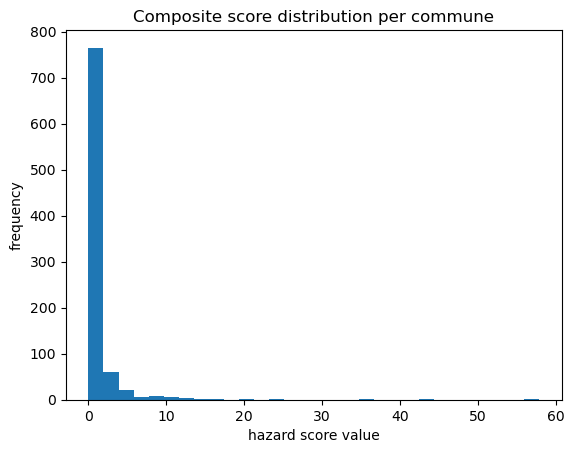

In [317]:
wildfire_sol_allfeat['hazard_score'].plot(kind='hist', bins=30)
plt.title('Composite score distribution per commune')
plt.xlabel('hazard score value')
plt.ylabel('frequency')
plt.show()

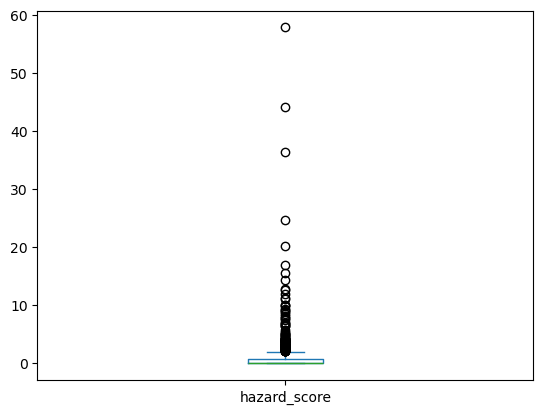

In [318]:
wildfire_sol_allfeat['hazard_score'].plot(kind='box')
plt.show()

### Looking for anomalies

In [319]:
# import wildfires and feat file per com
df_feat = wildfire_sol_allfeat.copy()

In [321]:
df_feat.shape

(878, 68)

In [322]:
df_feat.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier,geometry,freq_ratio,int_ratio,hazard_score
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,None,0.0,0.0,0.0,0.0,0,3.088448e+07,30.884478,204.503312,1.230371,226.946669,30848605.74,0.000000,0.0,0.000000,0.529457,0.0,0.0,0.316924,0.0,0.000000,0.0,0.153619,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18031,563,391.806664,72.000000,319.806664,18.229222,0.0,0.0,4931.069132,0.0,0.0,7496.926517,45538.750617,1144.702907,0.000000,0.0,POLYGON ((483825...,0.000000,0.000000,0.000000
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,None,0.0,0.0,0.0,0.0,0,9.333494e+06,9.333494,186.616136,0.897123,202.794667,9340490.12,0.000000,0.0,0.000000,0.760385,0.0,0.0,0.166536,0.0,0.000000,0.0,0.073079,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18191,174,100.960894,19.000000,81.960894,18.642536,0.0,0.0,1966.764684,0.0,0.0,935.608006,14531.272935,0.000000,0.000000,0.0,POLYGON ((474504...,0.000000,0.000000,0.000000
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,None,0.0,0.0,0.0,0.0,0,2.020450e+07,20.204500,179.768153,2.973080,183.403991,20231122.99,0.033896,0.0,0.317168,0.002792,0.0,0.0,0.429352,0.0,0.000000,0.0,0.084260,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.048776,0.031376,0.049057,0.003322,0.0,0.0,1.0,18197,9459,6358.346795,1048.243768,5310.103027,468.163036,0.0,0.0,1275.776736,0.0,0.0,7924.747824,92286.136623,1571.418744,13.403395,0.0,POLYGON ((461060...,0.000000,0.000000,0.000000
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,None,0.0,0.0,0.0,0.0,0,2.396071e+07,23.960707,142.246035,1.239222,174.603865,23874519.69,0.000000,0.0,0.267569,0.462428,0.0,0.0,0.106513,0.0,0.000000,0.0,0.057020,0.000000,0.0,0.0,0.0,0.000000,0.009614,0.0,0.000000,0.096856,0.000000,0.000000,0.0,0.0,1.0,18205,9645,4765.670674,344.496597,4421.174077,402.534026,0.0,0.0,1722.268497,0.0,0.0,4209.125511,63655.281625,8660.029489,0.000000,0.0,POLYGON ((453246...,0.000000,0.000000,0.000000
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,18020,1.0,300.0,300.0,0.0,1,2.550506e+07,25.505057,174.667557,2.474765,149.311005,25501723.03,0.000000,0.0,0.034372,0.402261,0.0,0.0,0.079703,0.0,0.041469,0.0,0.364056,0.026571,0.0,0.0,0.0,0.042398,0.000000,0.0,0.006150,0.000000,0.003021,0.000000,0.0,0.0,1.0,18020,843,528.993220,67.368132,461.625089,33.052269,0.0,0.0,10613.401336,0.0,0.0,22101.963711,36316.879444,0.000000,197.418750,0.0,POLYGON ((491723...,1.596364,0.014423,0.805393


#### Analyse target vs features

In [374]:
# keep wildfires data with most of the forest area burnt 

In [323]:
df_feat['Sum_Surface_burnforestall_ratio'] = ((df_feat['Sum_Surface_burnforest'] + df_feat['Sum_Surface_otherburnforest'])/df_feat['Sum_Surface_tot'])

In [324]:
df_feat['Sum_Surface_burnforestall_ratio'].isna().sum()

614

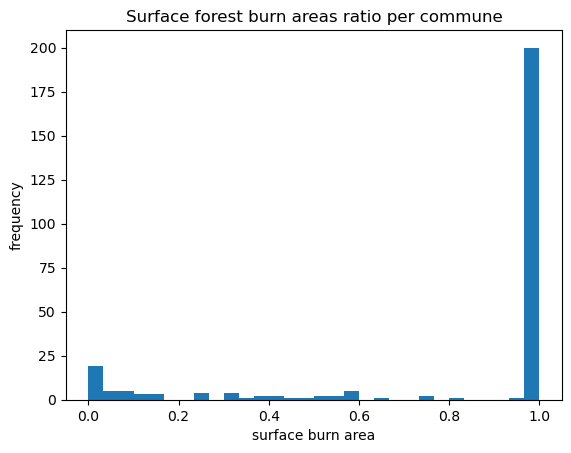

In [325]:
df_feat['Sum_Surface_burnforestall_ratio'].plot(kind='hist', bins=30)
plt.title('Surface forest burn areas ratio per commune')
plt.xlabel('surface burn area')
plt.ylabel('frequency')
plt.show()

In [326]:
df_feat_not_null = df_feat[~pd.isnull(df_feat['Sum_Surface_burnforestall_ratio'])]

In [327]:
(df_feat_not_null['Sum_Surface_burnforestall_ratio'] > 0.50).value_counts()

Sum_Surface_burnforestall_ratio
True     214
False     50
Name: count, dtype: int64

In [328]:
df_feat[df_feat['Sum_Surface_burnforestall_ratio'] > 0.50]['Sum_Surface_burnforestall_ratio'].isnull().sum()

0

In [329]:
df_feat = df_feat[df_feat['Sum_Surface_burnforestall_ratio'].isna() | (df_feat['Sum_Surface_burnforestall_ratio'] > 0.50)]

In [330]:
df_feat.shape

(828, 69)

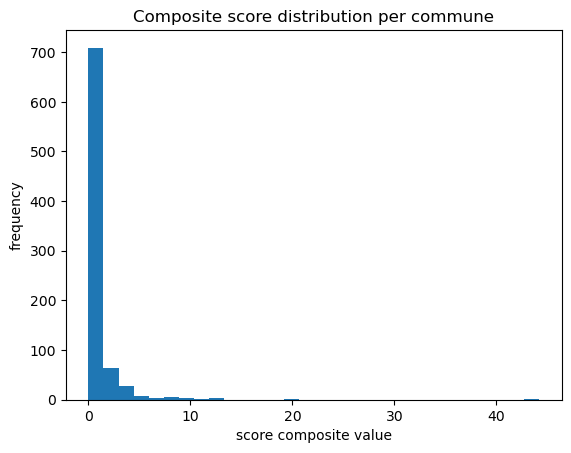

In [332]:
df_feat['hazard_score'].plot(kind='hist', bins=30)
plt.title('Composite score distribution per commune')
plt.xlabel('score composite value')
plt.ylabel('frequency')
plt.show()

#### Looking for outliers

In [333]:
# Calculate Q1, Q3, and IQR
Q1 = df_feat['hazard_score'].quantile(0.25)
Q3 = df_feat['hazard_score'].quantile(0.75)
IQR = Q3 - Q1

# Define outlier criteria
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = df_feat[(df_feat['hazard_score'] < lower_bound) | (df_feat['hazard_score'] > upper_bound)]

In [334]:
outliers.shape

(83, 69)

In [337]:
# control outliers
outliers[outliers['hazard_score'] == outliers['hazard_score'].max()]

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier,geometry,freq_ratio,int_ratio,hazard_score,Sum_Surface_burnforestall_ratio
695,COMMUNE_00000000...,Vienne-en-Val,VIENNE-EN-VAL,45335,Commune simple,1956,20,2,45,24,244500427,45335,3.0,2441000.0,1211000.0,1230000.0,1,3.579476e+07,35.794763,123.729767,0.872076,182.909188,35860145.32,0.0,0.0,0.018746,0.49415,0.0,0.0,0.0,0.021774,0.0,0.0,0.367134,0.08401,0.0,0.0,0.0,0.0,0.014185,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,45335,1956,876.87689,51.87931,824.99758,54.644865,0.0,0.0,13877.339206,0.0,0.0,21826.397312,49617.269133,0.0,0.0,0.0,POLYGON ((432641...,4.789091,83.618719,44.203905,1.0


In [338]:
# remove max outlier
df_feat = df_feat[df_feat['INSEE_COM'] != "45335"]

In [339]:
df_feat.shape

(827, 69)

In [340]:
print("composite score, valeur skew :", df_feat['hazard_score'].skew(),  "et valeur kurtosis", df_feat['hazard_score'].kurtosis())

composite score, valeur skew : 4.966197161471904 et valeur kurtosis 33.73058746850001


### mapping features 

In [359]:
# communes with or without wildfires

In [341]:
mee = geemap.Map(center=(47.70012, 1.89975), zoom=8)

In [342]:
mee

Map(center=[47.70012, 1.89975], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchD…

add Land cover 

In [343]:
dataset2018 = ee.Image("COPERNICUS/CORINE/V20/100m/2018")

In [344]:
landcover = dataset2018.select('landcover')

In [345]:
mee.addLayer(dataset2018, {}, 'CLC 2018')

In [346]:
# Add CLC legend
mee.add_legend(title='CORINE Land Cover', builtin_legend='COPERNICUS/CORINE/V20/100m')

add classified Sologne communes 

In [347]:
com_wildfires_ee = ee.FeatureCollection("users/ahohmann45/portfolio/com_wildfire")

In [348]:
info_com_wildfires = com_wildfires_ee.getInfo()

In [349]:
print('Properties of first feature:', info_com_wildfires['features'][0]['properties'])

Properties of first feature: {'Code INSEE': '', 'ID': 'COMMUNE_0000000009747285', 'INSEE_ARR': '1', 'INSEE_CAN': '02', 'INSEE_COM': '18027', 'INSEE_DEP': '18', 'INSEE_REG': '24', 'NOM': 'Bengy-sur-Craon', 'NOM_M': 'BENGY-SUR-CRAON', 'POPULATION': 650, 'SIREN_EPCI': '200007177', 'STATUT': 'Commune simple', 'Wildfires_': None, 'wildfire': 0}


In [350]:
palette = {
    0: "#a19c97",
    1: "#f58d42"
}

In [351]:
vis_params = {
    "color": "000000",
    "colorOpacity": 1,
    'lineType': 'solid',
    "fillColorOpacity": 0.66,
}

In [352]:
mee.add_styled_vector(com_wildfires_ee, column="wildfire", palette=palette, layer_name="Sologne communes target", **vis_params)

# Export features in a geojson

In [353]:
# Export the GeoDataFrame to a GeoJSON file
df_feat.to_crs(new_crs).to_file("data/df_feat_target.geojson" , driver='GeoJSON')

In [358]:
# Export the GeoDataFrame to a shp file
#df_feat.to_crs(new_crs).to_file(com_wildfire_path_shp)

In [357]:
# Export the GeoDataFrame to a parquet files
df_feat.to_crs(new_crs).to_parquet(com_wildfire_path_parquet, engine='pyarrow')

# Data preparation for streamlit app

In [369]:
communes_sol.dtypes

ID              object
NOM             object
NOM_M           object
INSEE_COM       object
STATUT          object
POPULATION       int64
INSEE_CAN       object
INSEE_ARR       object
INSEE_DEP       object
INSEE_REG       object
SIREN_EPCI      object
geometry      geometry
dtype: object

In [370]:
df_feat.describe()

,POPULATION,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier,freq_ratio,int_ratio,hazard_score,Sum_Surface_burnforestall_ratio
count,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,8.270000e+02,827.000000,827.000000,827.000000,827.000000,8.270000e+02,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,827.000000,213.000000
mean,1527.660218,0.577993,8795.390568,6366.290206,1871.990326,0.257557,2.299326e+07,22.993263,142.314777,1.299699,182.954425,2.298713e+07,0.000532,0.000180,0.039848,0.566198,0.000466,0.000051,0.097114,0.011520,0.004942,0.002984,0.169582,0.018703,0.000220,0.000264,0.000468,0.011591,0.025942,0.002108,0.001067,0.005928,0.035544,0.003114,0.000857,0.000738,0.999960,1527.701330,835.843459,85.979526,749.863934,82.039602,1.807164,186.429043,11893.973312,0.035542,0.493012,8869.952453,35488.516469,428.497105,103.339662,973.189613,0.922687,0.369495,0.646091,0.976497
std,5432.435034,1.581414,41716.532459,36750.770442,9214.753985,0.437554,1.705456e+07,17.054560,46.878498,0.849317,22.075760,1.705978e+07,0.010394,0.002660,0.090514,0.315378,0.006376,0.000995,0.166145,0.043981,0.024608,0.017772,0.191555,0.055652,0.003701,0.004384,0.006771,0.055923,0.044675,0.019821,0.006918,0.024876,0.068440,0.013915,0.013590,0.008620,0.001147,5432.425391,3104.565518,341.618860,2772.379720,260.236364,36.725876,840.376313,15397.214651,0.591565,13.358282,11771.857737,24386.710798,1738.858535,499.995203,2436.143111,2.524512,1.697397,1.745946,0.094519
min,13.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.099155e+06,1.099155,62.994437,0.035087,110.523549,1.091797e+06,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.967007,13.000000,14.363636,0.000000,12.363636,1.738528,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2195.974167,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500500
25%,270.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.165107e+07,11.651070,110.866037,0.717194,168.389768,1.165000e+07,0.000000,0.000000,0.000000,0.293834,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.008644,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,272.000000,163.908712,15.031381,144.785936,14.840508,0.000000,0.000000,3344.454802,0.000000,0.000000,2002.787931,19825.918219,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,539.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.838717e+07,18.387166,127.160723,1.101360,182.634568,1.837800e+07,0.000000,0.000000,0.000000,0.581400,0.000000,0.000000,0.016309,0.000000,0.000000,0.000000,0.098833,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,539.000000,309.926331,30.000000,275.190339,28.568843,0.000000,0.000000,7399.892281,0.000000,0.000000,4765.065171,30140.809254,0.000000,0.000000,0.000000

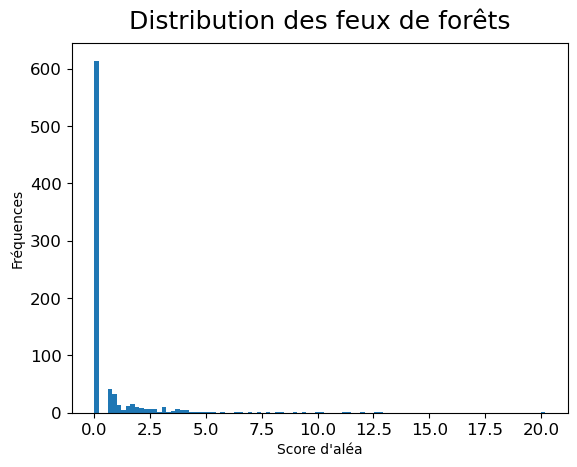

In [380]:
ax = df_feat['hazard_score'].plot(kind='hist', bins=100, fontsize=12)
ax.set_xlabel("Score d'aléa")
ax.set_ylabel("Fréquences")
plt.title('Distribution des feux de forêts', fontdict = {'fontsize': 18}, pad = 10.5)
plt.show()

In [381]:
# Define quantile thresholds
low_threshold = 2.5
medium_threshold = 5

# Function to classify based on quantiles
def classify_hazard(score):
    if score <= low_threshold:
        return 'Low'
    elif low_threshold < score <= medium_threshold:
        return 'Medium'
    else:
        return 'High'

# Apply classification
df_feat['hazard_class'] = df_feat['hazard_score'].apply(classify_hazard)

In [382]:
df_feat.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier,geometry,freq_ratio,int_ratio,hazard_score,Sum_Surface_burnforestall_ratio,hazard_class
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,None,0.0,0.0,0.0,0.0,0,3.088448e+07,30.884478,204.503312,1.230371,226.946669,30848605.74,0.000000,0.0,0.000000,0.529457,0.0,0.0,0.316924,0.0,0.000000,0.0,0.153619,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18031,563,391.806664,72.000000,319.806664,18.229222,0.0,0.0,4931.069132,0.0,0.0,7496.926517,45538.750617,1144.702907,0.000000,0.0,POLYGON ((483825...,0.000000,0.000000,0.000000,NaN,Low
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,None,0.0,0.0,0.0,0.0,0,9.333494e+06,9.333494,186.616136,0.897123,202.794667,9340490.12,0.000000,0.0,0.000000,0.760385,0.0,0.0,0.166536,0.0,0.000000,0.0,0.073079,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.0,18191,174,100.960894,19.000000,81.960894,18.642536,0.0,0.0,1966.764684,0.0,0.0,935.608006,14531.272935,0.000000,0.000000,0.0,POLYGON ((474504...,0.000000,0.000000,0.000000,NaN,Low
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,None,0.0,0.0,0.0,0.0,0,2.020450e+07,20.204500,179.768153,2.973080,183.403991,20231122.99,0.033896,0.0,0.317168,0.002792,0.0,0.0,0.429352,0.0,0.000000,0.0,0.084260,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.048776,0.031376,0.049057,0.003322,0.0,0.0,1.0,18197,9459,6358.346795,1048.243768,5310.103027,468.163036,0.0,0.0,1275.776736,0.0,0.0,7924.747824,92286.136623,1571.418744,13.403395,0.0,POLYGON ((461060...,0.000000,0.000000,0.000000,NaN,Low
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,None,0.0,0.0,0.0,0.0,0,2.396071e+07,23.960707,142.246035,1.239222,174.603865,23874519.69,0.000000,0.0,0.267569,0.462428,0.0,0.0,0.106513,0.0,0.000000,0.0,0.057020,0.000000,0.0,0.0,0.0,0.000000,0.009614,0.0,0.000000,0.096856,0.000000,0.000000,0.0,0.0,1.0,18205,9645,4765.670674,344.496597,4421.174077,402.534026,0.0,0.0,1722.268497,0.0,0.0,4209.125511,63655.281625,8660.029489,0.000000,0.0,POLYGON ((453246...,0.000000,0.000000,0.000000,NaN,Low
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,18020,1.0,300.0,300.0,0.0,1,2.550506e+07,25.505057,174.667557,2.474765,149.311005,25501723.03,0.000000,0.0,0.034372,0.402261,0.0,0.0,0.079703,0.0,0.041469,0.0,0.364056,0.026571,0.0,0.0,0.0,0.042398,0.000000,0.0,0.006150,0.000000,0.003021,0.000000,0.0,0.0,1.0,18020,843,528.993220,67.368132,461.625089,33.052269,0.0,0.0,10613.401336,0.0,0.0,22101.963711,36316.879444,0.000000,197.418750,0.0,POLYGON ((491723...,1.596364,0.014423,0.805393,1.0,Low


In [383]:
class_counts = df_feat['hazard_class'].value_counts()
# Display counts
print(class_counts)

hazard_class
Low       763
Medium     42
High       22
Name: count, dtype: int64


In [384]:
com_sol_score_alea = communes_sol.merge(df_feat[['INSEE_COM','hazard_score', 'hazard_class']], how='left', left_on='INSEE_COM', right_on='INSEE_COM')

In [385]:
com_sol_score_alea.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry,hazard_score,hazard_class
0,COMMUNE_00000000...,Blet,BLET,18031,Commune simple,563,10,2,18,24,200007177,POLYGON ((2.7877...,0.000000,Low
1,COMMUNE_00000000...,Raymond,RAYMOND,18191,Commune simple,174,09,2,18,24,241800424,POLYGON ((2.6648...,0.000000,Low
2,COMMUNE_00000000...,Saint-Amand-Mont...,SAINT-AMAND-MONT...,18197,Sous-préfecture,9459,12,2,18,24,200036135,POLYGON ((2.4905...,0.000000,Low
3,COMMUNE_00000000...,Saint-Doulchard,SAINT-DOULCHARD,18205,Commune simple,9645,13,1,18,24,241800507,POLYGON ((2.3839...,0.000000,Low
4,COMMUNE_00000000...,Bannay,BANNAY,18020,Commune simple,843,16,1,18,24,200069227,POLYGON ((2.8903...,0.805393,Low


In [ ]:
# Export the GeoDataFrame to a parquet files
com_sol_score_alea.to_crs(new_crs).to_parquet("data/com_score.parquet", engine='pyarrow')

In [16]:
# read a parquet files
df_score = gpd.read_parquet("data/com_score.parquet")

In [17]:
# create a folium map

In [18]:
# Get the bounds of your GeoDataFrame
bounds = df_score.total_bounds
# bounds returns [minx, miny, maxx, maxy]

# Convert to the format Folium expects: [[southWest], [northEast]]
folium_bounds = [[bounds[1], bounds[0]], [bounds[3], bounds[2]]]

In [19]:
def style_function(feature):
    hazard_score = feature['properties']['hazard_class']
    color_dict = {
        'Low': 'yellow',
        'Medium': 'orange',
        'High': 'red'
    }
    return {
        'fillColor': color_dict.get(hazard_score, 'gray'),  # 'gray' comme couleur par défaut
        'color': 'black',  # Couleur des bordures
        'weight': 1,       # Épaisseur des bordures
        'fillOpacity': 0.7 # Opacité du remplissage
    }

In [20]:
# Créer une carte centrée sur les limites
m = folium.Map(zoom_start=8)
m.fit_bounds(folium_bounds)

# create popup
popup = folium.GeoJsonPopup(
    fields=["NOM", "hazard_class"],  
    aliases=["Commune name", "Hazard class"],
    localize=True
)

f_com = folium.GeoJson(
    data=df_score,
    style_function=style_function,
    name = 'hazard class',
    popup=popup,
    show=True,
    tooltip=folium.GeoJsonTooltip(
        fields=["NOM"],
        aliases=["Commune"],
        sticky=True
    )
)
# add legend
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; right: 50px; 
            border:2px solid grey; z-index:9999; 
            background-color:white;
            padding:10px;
            font-size:14px;
            ">
            &nbsp; <b>Hazard Class</b> <br>
            &nbsp; <i style="background: red"></i>&nbsp;High<br>
            &nbsp; <i style="background: orange"></i>&nbsp;Medium<br>
            &nbsp; <i style="background: yellow"></i>&nbsp;Low
</div>
<style>
i {
    width: 18px;
    height: 18px;
    float: left;
    margin-right: 8px;
    opacity: 0.7;
}
</style>
'''
m.get_root().html.add_child(folium.Element(legend_html))

f_com.add_to(m)
folium.LayerControl().add_to(m)

In [21]:
m

In [37]:
df_score.loc[df_score['hazard_class'] == 'High']

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry,hazard_score,hazard_class
16,COMMUNE_00000000...,Blois,BLOIS,41018,Préfecture,46813,99,1,41,24,200030385,POLYGON ((1.2769...,20.187606,High
18,COMMUNE_00000000...,Pruniers-en-Sologne,PRUNIERS-EN-SOLOGNE,41185,Commune simple,2290,12,3,41,24,200018406,POLYGON ((1.7169...,8.427854,High
25,COMMUNE_00000000...,Villefranche-sur...,VILLEFRANCHE-SUR...,41280,Commune simple,2635,12,3,41,24,200018406,POLYGON ((1.7778...,5.661601,High
27,COMMUNE_00000000...,Vineuil,VINEUIL,41295,Commune simple,8067,15,1,41,24,200030385,POLYGON ((1.3556...,9.366253,High
84,COMMUNE_00000000...,Romorantin-Lanth...,ROMORANTIN-LANTH...,41194,Sous-préfecture,18115,10,3,41,24,200018406,POLYGON ((1.7410...,7.827321,High
147,COMMUNE_00000000...,Saint-Georges-su...,SAINT-GEORGES-SU...,41211,Commune simple,2723,07,3,41,24,200072064,POLYGON ((1.1063...,5.103433,High
183,COMMUNE_00000000...,Souesmes,SOUESMES,41249,Commune simple,1028,13,3,41,24,244100806,POLYGON ((2.2350...,11.309176,High
293,COMMUNE_00000000...,Veuzain-sur-Loire,VEUZAIN-SUR-LOIRE,41167,Commune simple,3364,08,1,41,24,200030385,POLYGON ((1.1128...,7.428764,High
316,COMMUNE_00000000...,Gièvres,GIEVRES,41097,Commune simple,2311,12,3,41,24,200018406,POLYGON ((1.7158...,10.132435,High
382,COMMUNE_00000000...,Cléry-Saint-André,CLERY-SAINT-ANDRE,45098,Commune simple,3520,01,2,45,24,200070183,POLYGON ((1.7695...,5.446998,High


In [41]:
wildfire_sol_allfeat[wildfire_sol_allfeat['INSEE_COM']== '45054']

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,Code INSEE,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,CODGEO,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier,geometry
555,COMMUNE_00000000...,Briarres-sur-Ess...,BRIARRES-SUR-ESS...,45054,Commune simple,533,09,3,45,24,200071850,45054,2.0,151000.0,1000.0,150000.0,1,8.256074e+06,8.256074,109.408894,1.45838,170.64346,8240725.92,0.0,0.0,0.0,0.907672,0.0,0.0,0.090742,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.001587,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,45054,533,284.886545,26.701325,258.18522,64.558528,0.0,0.0,10490.598531,0.0,0.0,2229.038763,12891.416716,0.0,366.624522,0.0,POLYGON ((456281...


In [42]:
wildfire_sol_allfeat.describe()

,POPULATION,Wildfires_count,Sum_Surface_tot,Sum_Surface_burnforest,Sum_Surface_otherburnforest,wildfire_bin,area_sqm,area_sqkm,MNT,slope,aspect,Class_sum,Class_111,Class_331,Class_112,Class_211,Class_131,Class_132,Class_231,Class_313,Class_511,Class_512,Class_311,Class_312,Class_411,Class_141,Class_122,Class_221,Class_243,Class_222,Class_142,Class_121,Class_242,Class_324,Class_124,Class_322,Class_sum_percentage,P21_POP,P21_LOG,P21_LOGVAC,P21_OCCLOG,P21_density,Bac ou liaison maritime,Bretelle,Chemin,Escalier,Rond-point,Route empierrée,Route à 1 chaussée,Route à 2 chaussées,Sentier,Type autoroutier
count,878.000000,878.000000,8.780000e+02,8.780000e+02,8.780000e+02,878.000000,8.780000e+02,878.000000,878.000000,878.000000,878.000000,8.780000e+02,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,1494.993166,0.626424,1.971828e+04,8.674968e+03,3.570317e+03,0.300683,2.337991e+07,23.379908,143.181627,1.312999,182.976758,2.337388e+07,0.000501,0.000170,0.038518,0.568376,0.000468,0.000048,0.098301,0.011166,0.004889,0.002923,0.169756,0.019036,0.000208,0.000248,0.000441,0.011082,0.025608,0.001985,0.001043,0.005699,0.034906,0.003063,0.000832,0.000695,0.999962,1495.031891,819.163981,84.825767,734.338215,79.153876,1.702192,178.634228,11936.899999,0.033478,0.464374,8926.491339,36065.904986,416.250759,102.344260,946.110499
std,5281.650119,1.558245,1.126025e+05,5.704074e+04,4.287775e+04,0.458817,1.708148e+07,17.081476,46.923243,0.846616,21.947720,1.708685e+07,0.010088,0.002582,0.088200,0.312520,0.006247,0.000966,0.166628,0.042857,0.024198,0.017334,0.189390,0.057146,0.003593,0.004255,0.006572,0.054420,0.043929,0.019243,0.006764,0.024245,0.067220,0.013595,0.013209,0.008368,0.001113,5281.641017,3017.776560,332.406107,2694.660455,252.950046,35.644536,818.630542,15189.515618,0.574167,12.964567,11648.075145,24387.529892,1695.584647,489.818441,2401.883284
min,13.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,1.099155e+06,1.099155,62.994437,0.035087,110.523549,1.091797e+06,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.967007,13.000000,14.363636,0.000000,12.363636,1.738528,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2195.974167,0.000000,0.000000,0.000000
25%,267.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,1.192059e+07,11.920592,111.352977,0.729968,168.486628,1.192090e+07,0.000000,0.000000,0.000000,0.301350,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.014810,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,267.250000,164.899076,15.754199,144.830533,14.670515,0.000000,0.000000,3304.220516,0.000000,0.000000,2076.732410,20337.876611,0.000000,0.000000,0.000000
50%,538.500000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,1.869660e+07,18.696600,127.515015,1.127971,182.826958,1.866836e+07,0.000000,0.000000,0.000000,0.593058,0.000000,0.000000,0.018753,0.000000,0.000000,0.000000,0.099384,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,538.500000,313.859184,30.286260,278.806694,27.974507,0.000000,0.000000,7514.005821,0.000000,0.000000,4936.471427,30924.593947,0.000000,0.000000,0.000000
75%,1155.750000,1.000000,2.300000e+02,0.000000e+00,0.000000e+00,1.000000,2.905915e+07,29.059145,170.176288,1.633988,196.967208,2.908293e+07,0.000000,0.000000,0.040804,0.855646,0.000000,0.000000,0.120181,0.00